<a href="https://colab.research.google.com/github/amrit-thapa-2044/SlopeMotionHKH/blob/main/PyGMTSAR_Create_interferrogram_track_121_nepal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Load Modules to Check Environment

In [ ]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [ ]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt > /dev/null
        # GMTSAR codes are not so good to be compiled by modern GCC
        !apt install gcc-9
        !update-alternatives --install /usr/bin/gcc gcc /usr/bin/gcc-9 10
        !update-alternatives --config gcc
        !gcc --version
        !rm -fr /usr/local/GMTSAR
        !cd /usr/local && git clone --branch master https://github.com/gmtsar/gmtsar GMTSAR > /dev/null
        # revert recent broken commit
        !cd /usr/local/GMTSAR && git checkout e98ebc0f4164939a4780b1534bac186924d7c998 > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null
        # fix for missed script, use bash instead of csh interpretator
        # note: csh messes stdout and stderr in Docker environment, it's resolved in PyGMTSAR code
        !echo '#!/bin/sh' > /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !echo echo /usr/local/GMTSAR/share/gmtsar >> /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !chmod a+x /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !/usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        # test one GMTSAR binary
        !/usr/local/GMTSAR/bin/make_s1a_tops



Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  cpp-9 gcc-9-base libasan5 libgcc-9-dev
Suggested packages:
  gcc-9-locales gcc-9-multilib gcc-9-doc
The following NEW packages will be installed:
  cpp-9 gcc-9 gcc-9-base libasan5 libgcc-9-dev
0 upgraded, 5 newly installed, 0 to remove and 18 not upgraded.
Need to get 27.5 MB of archives.
After this operation, 89.0 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 gcc-9-base amd64 9.5.0-1ubuntu1~22.04 [19.8 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 cpp-9 amd64 9.5.0-1ubuntu1~22.04 [10.6 MB]
Get:3 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 libasan5 amd64 9.5.0-1ubuntu1~22.04 [3,140 kB]
Get:4 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 libgcc-9-dev amd64 9.5.0-1ubuntu1~22.04 [2,520 kB]
Get:5 http://archive.ubunt

### Define ENV Variables for Jupyter Instance

In [ ]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

env: PATH=/opt/bin:/usr/local/nvidia/bin:/usr/local/cuda/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/tools/node/bin:/tools/google-cloud-sdk/bin:/usr/local/GMTSAR/bin/


### Install Python Modules

Maybe you need to restart your notebook, follow the instructions printing below.

The installation takes a long time on fresh Debian 10 and a short time on Google Colab

In [ ]:
!{sys.executable} --version

Python 3.10.12


In [ ]:
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install matplotlib seaborn geoviews hvplot datashader bokeh > /dev/null

In [ ]:
!{sys.executable} -m pip install pygmtsar==2023.2.21 'dask[array]==2022.12.1' > /dev/null

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
geoviews 1.10.1 requires bokeh<3.3.0,>=3.1.0, but you have bokeh 2.4.3 which is incompatible.
panel 1.2.3 requires bokeh<3.3.0,>=3.1.1, but you have bokeh 2.4.3 which is incompatible.


## Load and Setup Python Modules

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')
from dask.distributed import Client

In [ ]:
# plotting modules
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [ ]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

In [ ]:
from pygmtsar import SBAS
# progress indicator for the long operations
from pygmtsar import tqdm_dask
import dask

## Define 2 Sentinel-1 SLC Scenes and Processing Parameters

When you need more scenes and SBAS analysis  see examples on PyGMTSAR GitHub page https://github.com/mobigroup/gmtsar

In [ ]:
#
SCENES = ['S1A_IW_SLC__1SDV_20220318T001134_20220318T001201_042368_050D2D_D946',
          'S1A_IW_SLC__1SDV_20220330T001134_20220330T001201_042543_051321_A9B7']
ORBIT        = 'D' # decending
SUBSWATH     = 123

In [ ]:
WORKDIR      = 'raw_121'
DATADIR      = 'data_121'
DEMFILE      = None
POLARIZATION = 'VV'
# output resolution, meters
RESOLUTION   = 90

In [ ]:
# Magnitude Mw 7.8 & 7.5
# Region    CENTRAL TURKEY
# Date      2023-02-06
# EPICENTERS = [37.24, 38.11,37.08, 37.17]

## Download and Unpack Datasets (Optional)

### Input ASF (Earthdata) User and Password

When data directory does not exists or empty the Sentinel-1 scenes downloaded from Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you do not have a Earthdata Login, create one at https://urs.earthdata.nasa.gov//users/new

In [ ]:
if os.path.isdir(DATADIR) and len([fname for fname in os.listdir(DATADIR) if fname[0]!='.'])>0:
    print ('Data directory already exists and it is not empty, miss downloading')
else:
    import time
    import getpass
    print ('Data directory does not exists or it is empty, download the dataset')
    # to print the message BEFORE the usename and password fields
    time.sleep(1)
    username = getpass.getpass('Please enter your ASF username and press Enter key:')
    password = getpass.getpass('Please enter your ASF password and press Enter key:')
    # download the scenes from ASF and unpack only required files to data directory
    for scene in SCENES:
        url = f'https://datapool.asf.alaska.edu/SLC/S{scene[2:3]}/{scene}.zip'
        !wget --user={username} --password={password} -qc {url}
        !unzip -j -n {scene}.zip '*.SAFE/*/s1?-iw?-slc-{POLARIZATION.lower()}-*' -d {DATADIR}

# cleanup
!rm -rf *.zip

Data directory does not exists or it is empty, download the dataset
Please enter your ASF username and press Enter key:··········
Please enter your ASF password and press Enter key:··········
Archive:  S1A_IW_SLC__1SDV_20220318T001134_20220318T001201_042368_050D2D_D946.zip
  inflating: data_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.xml  
  inflating: data_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.xml  
  inflating: data_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.xml  
  inflating: data_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.tiff  
  inflating: data_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.tiff  
  inflating: data_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.tiff  
Archive:  S1A_IW_SLC__1SDV_20220330T001134_20220330T001201_042543_051321_A9B7.zip
  inflating: data_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-

## Run Local Dask Cluster

Launch Dask cluster for big data processing. Use "Dashboard" link below for the local cluster state and execution monitoring.

In [ ]:
# cleanup for repeatable runs
if 'client' in globals():
    client.close()
client = Client()
client

INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:40745
INFO:distributed.scheduler:  dashboard at:            127.0.0.1:8787
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:42855'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:36167'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:44789', name: 0, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:44789
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:33284
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:37575', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:37575
INFO:distributed.core:Startin

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 2
Total threads: 2,Total memory: 12.68 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:40745,Workers: 2
Dashboard: http://127.0.0.1:8787/status,Total threads: 2
Started: Just now,Total memory: 12.68 GiB
Comm: tcp://127.0.0.1:44789,Total threads: 1
Dashboard: http://127.0.0.1:35391/status,Memory: 6.34 GiB
Nanny: tcp://127.0.0.1:42855,


## Init SBAS

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Select Original Secenes and Download DEM and Orbits Later

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [ ]:
sbas = SBAS(DATADIR, DEMFILE, basedir=WORKDIR,
    filter_orbit=ORBIT,
    filter_subswath=SUBSWATH,
    filter_polarization=POLARIZATION)

### Show the Dataset

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-03-18,2022-03-18 00:11:35,D,S1A,VV,1,data_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.tiff,data_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.xml,None,"POLYGON ((86.76958 26.52363, 87.68035 26.38717, 87.91236 27.93572, 87.00159 28.07217, 86.76958 26.52363))"
2022-03-18,2022-03-18 00:11:36,D,S1A,VV,2,data_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.tiff,data_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.xml,None,"POLYGON ((85.89524 26.62288, 86.81842 26.47375, 87.06557 28.00373, 86.14238 28.15286, 85.89524 26.62288))"
2022-03-18,2022-03-18 00:11:34,D,S1A,VV,3,data_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.tiff,data_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.xml,None,"POLYGON ((85.15218 26.85494, 85.97488 26.72160, 86.22279 28.25112, 85.40009 28.38447, 85.15218 26.85494))"
2022-03-30,2022-03-30 00:11:35,D,S1A,VV,1,data_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.tiff,data_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.xml,None,"POLYGON ((86.76932 26.52409, 87.68000 26.38766, 87.91198 27.93610, 87.00129 28.07253, 86.76932 26.52409))"
2022-03-30,2022-03-30 00:11:36,D,S1A,VV,2,data_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.tiff,data_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.xml,None,"POLYGON ((85.89508 26.62333, 86.81814 26.47422, 87.06529 28.00421, 86.14223 28.15332, 85.89508 26.62333))"
2022-03-30,2022-03-30 00:11:34,D,S1A,VV,3,data_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.tiff,data_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.xml,None,"POLYGON ((85.15201 26.85552, 85.97468 26.72219, 86.22256 28.25159, 85.39989 28.38493, 85.15201 26.85552))"


### Download Sentinel-1 Orbits

The function below downloads orbit files.
Besides, for faster processing we can automatically use pre-downloaded orbit files in data directory.

In [ ]:
# also, we can place pre-downloaded orbit files to data directory
sbas.download_orbits()

MD5 checksumming:   0%|          | 0.00/4.41M [00:00<?, ?B/s]

MD5 checksumming:   0%|          | 0.00/4.41M [00:00<?, ?B/s]

Fetching archival status: 100%|##########| 1/1 [00:03<00:00,  3.05s/product]

### Show the Dataset

All the orbit files found, see 'orbitpath' column

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-03-18,2022-03-18 00:11:35,D,S1A,VV,1,data_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.tiff,data_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((86.76958 26.52363, 87.68035 26.38717, 87.91236 27.93572, 87.00159 28.07217, 86.76958 26.52363))"
2022-03-18,2022-03-18 00:11:36,D,S1A,VV,2,data_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.tiff,data_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((85.89524 26.62288, 86.81842 26.47375, 87.06557 28.00373, 86.14238 28.15286, 85.89524 26.62288))"
2022-03-18,2022-03-18 00:11:34,D,S1A,VV,3,data_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.tiff,data_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((85.15218 26.85494, 85.97488 26.72160, 86.22279 28.25112, 85.40009 28.38447, 85.15218 26.85494))"
2022-03-30,2022-03-30 00:11:35,D,S1A,VV,1,data_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.tiff,data_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((86.76932 26.52409, 87.68000 26.38766, 87.91198 27.93610, 87.00129 28.07253, 86.76932 26.52409))"
2022-03-30,2022-03-30 00:11:36,D,S1A,VV,2,data_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.tiff,data_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((85.89508 26.62333, 86.81814 26.47422, 87.06529 28.00421, 86.14223 28.15332, 85.89508 26.62333))"
2022-03-30,2022-03-30 00:11:34,D,S1A,VV,3,data_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.tiff,data_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((85.15201 26.85552, 85.97468 26.72219, 86.22256 28.25159, 85.39989 28.38493, 85.15201 26.85552))"


## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

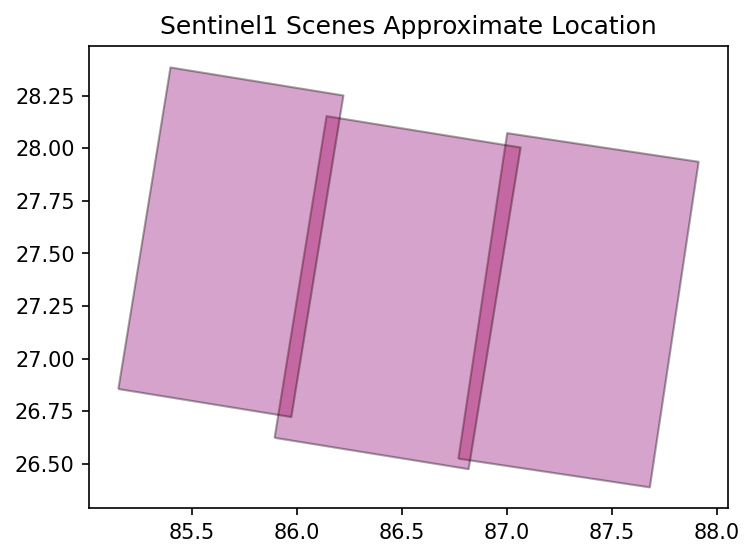

In [ ]:
plt.figure(figsize=(8,4), dpi=150)
gdf = sbas.to_dataframe()
cmap = plt.cm.get_cmap('bwr', len(gdf.index.unique()))
colors = dict([(v,cmap(k)) for k,v in enumerate(gdf.index.unique())])
gdf.reset_index().plot(color=[colors[k] for k in gdf.index], alpha=0.2, edgecolor='black', ax=plt.gca())
plt.scatter(x=sbas.get_pins()[::2], y=sbas.get_pins()[1::2], color='black', s=10)
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='black')
plt.title('Sentinel1 Scenes Approximate Location', fontsize=12)
plt.show()

### Crop the Frame (Optional)

When we satisfied with the pins positions and the target frame we are ready to crop the frame.
Just comment the code cell below when you don't need to crop the area.

In [ ]:
sbas.reframe_parallel()

NOTE subswath 1: pin1 is not defined, master image corner coordinate will be used
NOTE subswath 1: pin2 is not defined, master image corner coordinate will be used
NOTE subswath 2: pin1 is not defined, master image corner coordinate will be used
NOTE subswath 2: pin2 is not defined, master image corner coordinate will be used
NOTE subswath 3: pin1 is not defined, master image corner coordinate will be used
NOTE subswath 3: pin2 is not defined, master image corner coordinate will be used


Reframing:   0%|          | 0/6 [00:00<?, ?it/s]

### Show the updated dataset (Optional)

The newly created scene frames .tiff and .xml files plus orbit files .EOF can be copied for the future processing using `SBAS.backup()` function to use them instead of the original full scenes.

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-03-18,2022-03-18 00:11:35,D,S1A,VV,1,raw_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.tiff,raw_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((86.76958 26.52363, 87.68035 26.38717, 87.91236 27.93572, 87.00159 28.07217, 86.76958 26.52363))"
2022-03-18,2022-03-18 00:11:36,D,S1A,VV,2,raw_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.tiff,raw_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((85.89524 26.62288, 86.81842 26.47375, 87.06557 28.00373, 86.14238 28.15286, 85.89524 26.62288))"
2022-03-18,2022-03-18 00:11:34,D,S1A,VV,3,raw_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.tiff,raw_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((85.15218 26.85494, 85.97488 26.72160, 86.22279 28.25112, 85.40009 28.38447, 85.15218 26.85494))"
2022-03-30,2022-03-30 00:11:35,D,S1A,VV,1,raw_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.tiff,raw_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((86.76932 26.52409, 87.68000 26.38766, 87.91198 27.93610, 87.00129 28.07253, 86.76932 26.52409))"
2022-03-30,2022-03-30 00:11:36,D,S1A,VV,2,raw_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.tiff,raw_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((85.89508 26.62333, 86.81814 26.47422, 87.06529 28.00421, 86.14223 28.15332, 85.89508 26.62333))"
2022-03-30,2022-03-30 00:11:34,D,S1A,VV,3,raw_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.tiff,raw_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.xml,raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((85.15201 26.85552, 85.97468 26.72219, 86.22256 28.25159, 85.39989 28.38493, 85.15201 26.85552))"


### Download SRTM DEM

The function below downloads SRTM1 or SRTM3 DEM and converts heights to ellipsoidal model using EGM96 grid.
Besides, for faster processing we can use pre-defined DEM file as explained above.

The DEM grid is NetCDF file.

In [ ]:
sbas.download_dem(backend='GMT', resolution_meters=RESOLUTION)

DEM Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

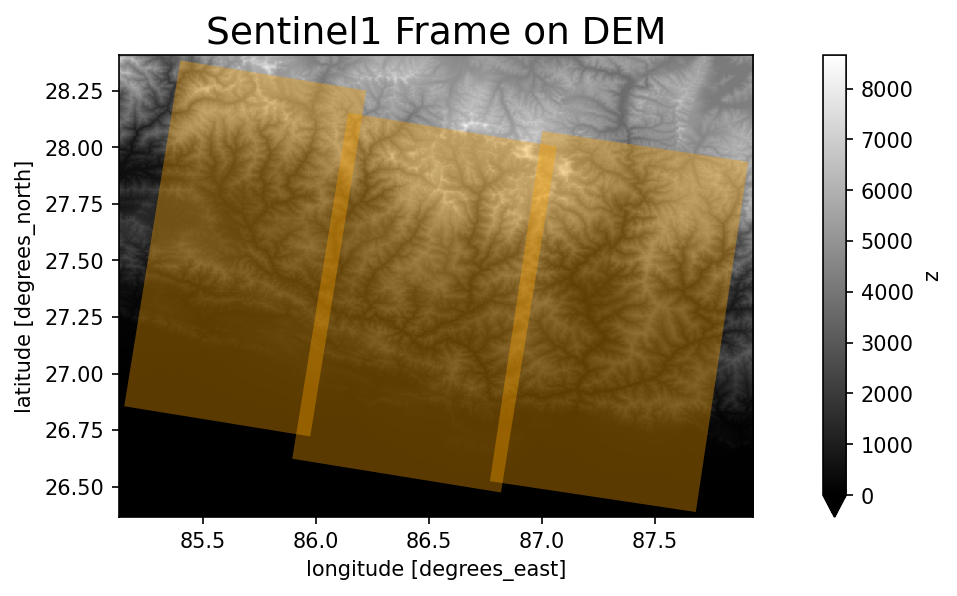

In [ ]:
plt.figure(figsize=(12,4), dpi=150)
dem = sbas.get_dem()
dem[::4,::4].plot.imshow(cmap='gray', vmin=0)
sbas.to_dataframe().plot(color='orange', alpha=0.2, ax=plt.gca())
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='black')
plt.title('Sentinel1 Frame on DEM', fontsize=18)
plt.show()

## Align a Pair of Images

In [ ]:
sbas.stack_parallel()

Reference:   0%|          | 0/3 [00:00<?, ?it/s]

Aligning:   0%|          | 0/3 [00:00<?, ?it/s]

## DEM in Radar Coordinates

In [ ]:
sbas.topo_ra_parallel()

INFO:distributed.utils_perf:full garbage collection released 20.53 MiB from 16902 reference cycles (threshold: 9.54 MiB)


Radar Transform Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-871b03f0-6423-11ee-9ce3-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:34048
INFO:distributed.scheduler:Receive client connection: Client-worker-88787eb7-6423-11ee-9ce1-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:34080


Radar Transform Computing sw2:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Transform Computing sw3:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/12 [00:00<?, ?it/s]

Radar Topography Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/12 [00:00<?, ?it/s]

Radar Topography Computing sw2:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/12 [00:00<?, ?it/s]

Radar Topography Computing sw3:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Load Grids

The grids are NetCDF files processing as xarray DataArrays.

In [ ]:
topo_ra = sbas.get_topo_ra()
# workaround
topo_ra = topo_ra if isinstance(topo_ra, list) else [topo_ra]

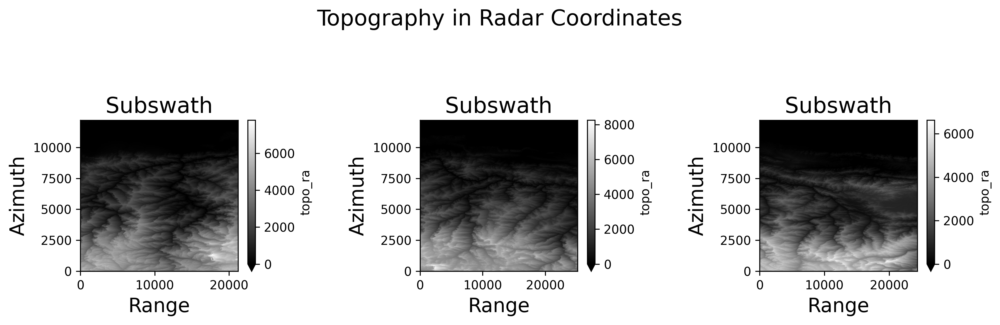

In [ ]:
fig = plt.figure(figsize=(12,4), dpi=300)

subswaths = len(topo_ra)
for subswath in range(subswaths):
    ax = fig.add_subplot(1, subswaths, subswath + 1)
    topo_ra[subswath][::4,::4].plot.imshow(cmap='gray', vmin=0, ax=ax)
    plt.xlabel('Range', fontsize=16)
    plt.ylabel('Azimuth', fontsize=16)
    plt.title('Subswath', fontsize=18)

plt.suptitle('Topography in Radar Coordinates', fontsize=18)
plt.tight_layout(pad=3)
plt.show()

## Interferogram

Define a single interferogram or a SBAS series. Make direct and reverse interferograms (from past to future or from future to past).

Decimation is useful to save disk space. Geocoding results are always produced on the provided DEM grid so the output grid and resolution are the same to the DEM. By this way, ascending and descending orbit results are always defined on the same grid by design. The internal processing cells is about 15 x 15 meters size and for default output 60m resolution (like to GMTSAR and GAMMA software) decimation 4x4 is reasonable. For the default wavelength=200 for Gaussian filter 1/4 of wavelength is approximately equal to ~60 meters and better resolution is mostly useless (while it can be used for small objects detection). For wavelength=400 meters use 90m or 120m DEM resolution with decimation 6x6 or 8x8 and for wavelength=100 meters use decimation 2x2.

The grids are NetCDF files processing as xarray DataArrays.

In [ ]:
# for a pair of scenes only two interferograms can be produced
# this one is selected for scenes sorted by the date in direct order
pairs = [sbas.to_dataframe().index.unique()]
pairs

[Index(['2022-03-18', '2022-03-30'], dtype='object', name='date')]

In [ ]:
# debug=True produces helpful information about processing resolution
decimator = sbas.pixel_decimator(resolution_meters=RESOLUTION)

# default parameters: wavelength=200, psize=32, func=None (no postprocessing)
sbas.intf_parallel(pairs, func=decimator, n_jobs=1)

Interferograms:   0%|          | 0/3 [00:00<?, ?it/s]

## Merge Subswaths (Optional)

That's the right time to merge subswath interferograms together before unwrapping them. While unwrapping is possible for separate subswath interferograms the merged interferogram unwrapping is more robust and returns better results when unconnected areas on separate subswaths are connected on the merged interferogram.

In [ ]:
sbas.merge_parallel(pairs)

Merging Subswaths:   0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-03-18,2022-03-18 00:11:34,D,S1A,VV,123,"[raw_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.tiff, raw_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.tiff, raw_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.tiff]","[raw_121/s1a-iw1-slc-vv-20220318t001135-20220318t001200-042368-050d2d-004.xml, raw_121/s1a-iw2-slc-vv-20220318t001136-20220318t001201-042368-050d2d-005.xml, raw_121/s1a-iw3-slc-vv-20220318t001134-20220318t001159-042368-050d2d-006.xml]",raw_121/S1A_OPER_AUX_POEORB_OPOD_20220406T081728_V20220316T225942_20220318T005942.EOF,"POLYGON ((87.00159 28.07217, 87.91236 27.93572, 87.68035 26.38717, 86.82513 26.51530, 86.81842 26.47375, 85.89524 26.62288, 85.91281 26.73166, 85.15218 26.85494, 85.40009 28.38447, 86.22279 28.25112, 86.20522 28.14271, 86.99309 28.01544, 87.00159 28.07217))"
2022-03-30,2022-03-30 00:11:34,D,S1A,VV,123,"[raw_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.tiff, raw_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.tiff, raw_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.tiff]","[raw_121/s1a-iw1-slc-vv-20220330t001135-20220330t001200-042543-051321-004.xml, raw_121/s1a-iw2-slc-vv-20220330t001136-20220330t001201-042543-051321-005.xml, raw_121/s1a-iw3-slc-vv-20220330t001134-20220330t001200-042543-051321-006.xml]",raw_121/S1A_OPER_AUX_POEORB_OPOD_20220418T081626_V20220328T225942_20220330T005942.EOF,"POLYGON ((87.00129 28.07253, 87.91198 27.93610, 87.68000 26.38766, 86.82485 26.51577, 86.81814 26.47422, 85.89508 26.62333, 85.91268 26.73224, 85.15201 26.85552, 85.39989 28.38493, 86.22256 28.25159, 86.20499 28.14318, 86.99281 28.01592, 87.00129 28.07253))"


## Build Geocoding Matrices (Optional)

Source grid pixels can be translated to the target grid pixels very fast using the geocoding matrices.

In [ ]:
sbas.geocode_parallel(pairs)

Radar Transform Computing sw123:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/35 [00:00<?, ?it/s]

Radar Topography Computing sw123:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.core:Event loop was unresponsive in Nanny for 4.16s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 4.16s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 4.16s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.


Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/35 [00:00<?, ?it/s]

Build ll2ra Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Build ra2ll Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

## Calculate Epicenters in Radar Coordinates (Optional)

In [ ]:
# epicenters in radar coordinates
# EPICENTERS_ra = sbas.PRM().SAT_llt2rat(np.c_[ np.reshape(EPICENTERS,(2,-1)), np.zeros(2) ] )[:,:2].reshape(-1)
# EPICENTERS_ra

array([35744.11817372,  6042.48332326, 34581.65647173, 13595.43751986])

### Load Grids

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays. For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
phasefilt_ra = sbas.open_grids(pairs, 'phasefilt')[0]
corr_ra = sbas.open_grids(pairs, 'corr')[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
phasefilt = sbas.open_grids(pairs, 'phasefilt', geocode=True, crop_valid=True)[0]
corr = sbas.open_grids(pairs, 'corr', geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

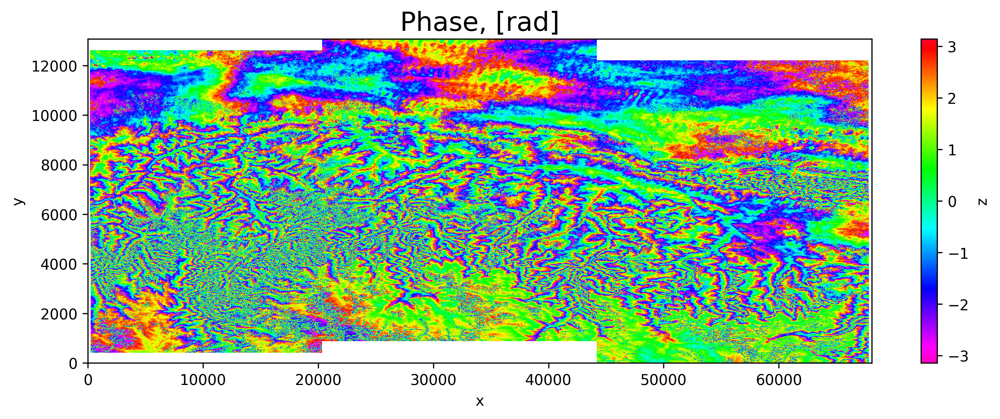

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
phasefilt_ra.plot.imshow(vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r')
# plt.scatter(EPICENTERS_ra[::2], EPICENTERS_ra[1::2], marker='*', s=100, color='red')
plt.title('Phase, [rad]', fontsize=18)
plt.show()

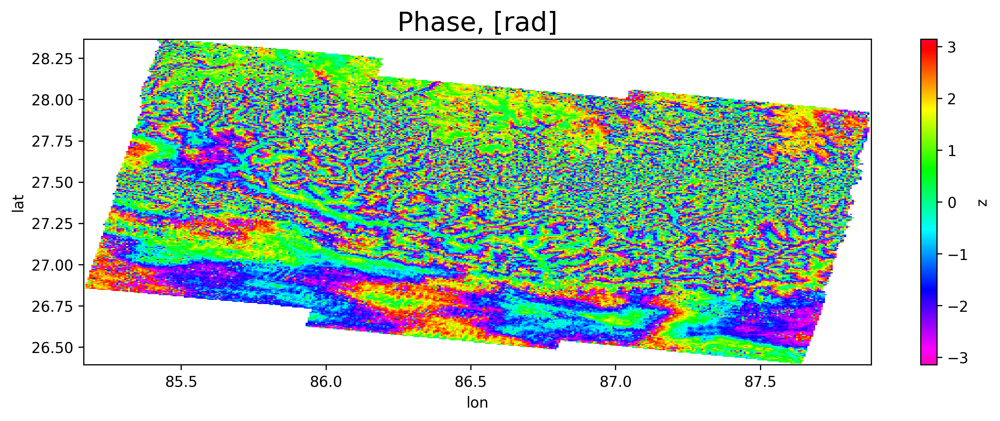

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
phasefilt[::8,::8].plot.imshow(vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Phase, [rad]', fontsize=18)
plt.show()

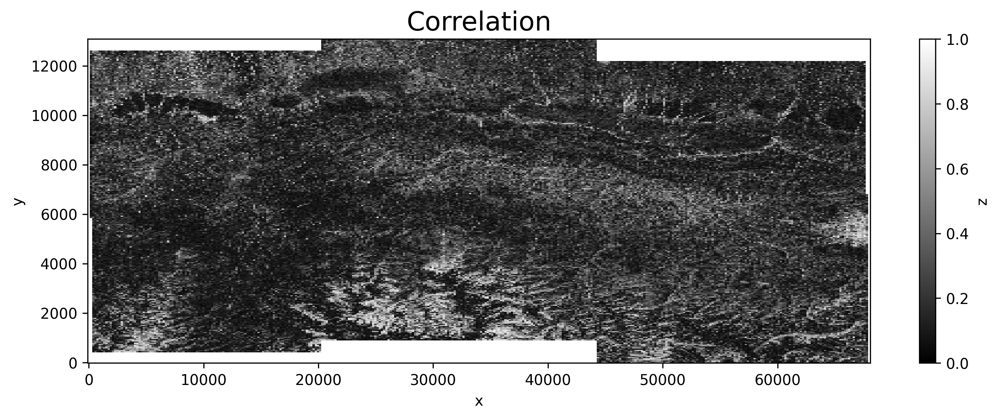

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
corr_ra[::8,::8].plot.imshow(vmin=-0, vmax=1, cmap='gray')
# plt.scatter(EPICENTERS_ra[::2], EPICENTERS_ra[1::2], marker='*', s=100, color='red')
plt.title('Correlation', fontsize=18)
plt.show()

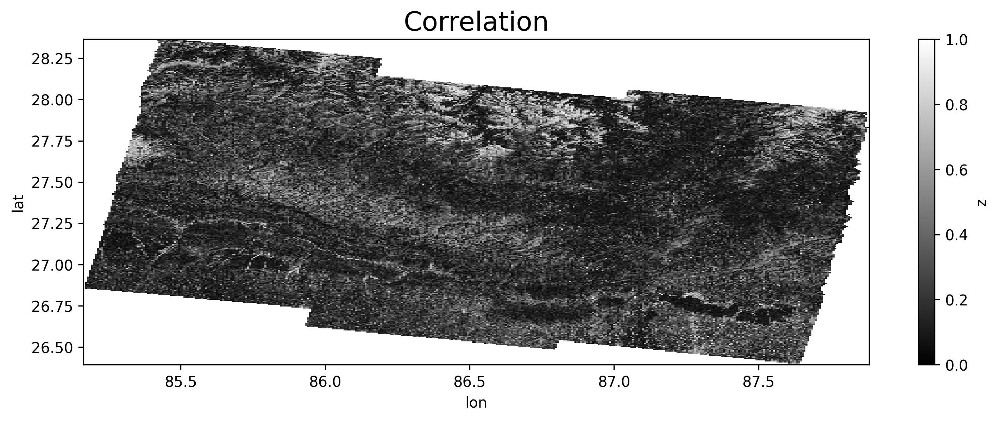

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
corr[::8,::8].plot.imshow(vmin=-0, vmax=1, cmap='gray')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Correlation', fontsize=18)
plt.show()

## Landmask

Interferogram presents just a noise for water surfaces and unwrapping is meaningless long for these areas. Landmask allows to exclude water sufraces to produce better looking unwrapping results and much faster. Landmask in geographic coordinates is suitable to check it on the map while for unwrapping required landmask in radar coordinates.

In [ ]:
sbas.download_landmask()

Landmask Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

### Load Grid

In [ ]:
landmask = sbas.get_landmask()

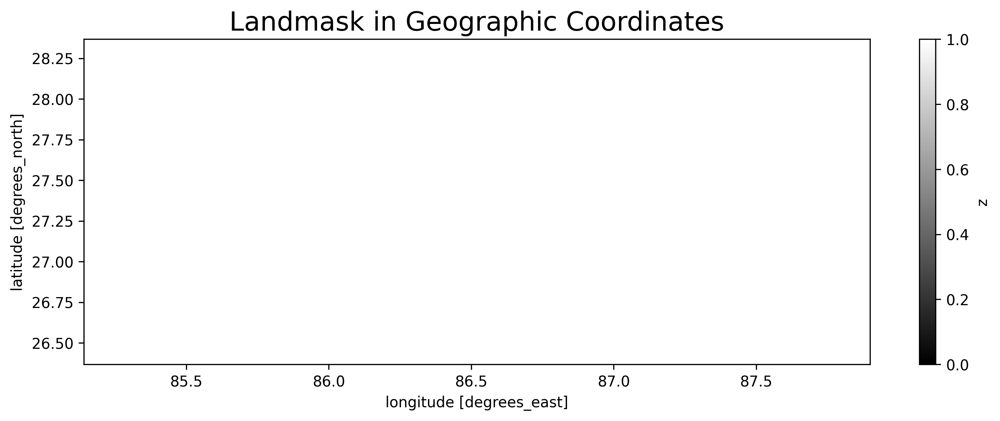

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
landmask.plot.imshow(vmin=0, vmax=1, cmap='gray')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Landmask in Geographic Coordinates', fontsize=18)
plt.show()

### Load Grid in Radar Coordinates

In [ ]:
landmask_ra = sbas.get_landmask(inverse_geocode=True)

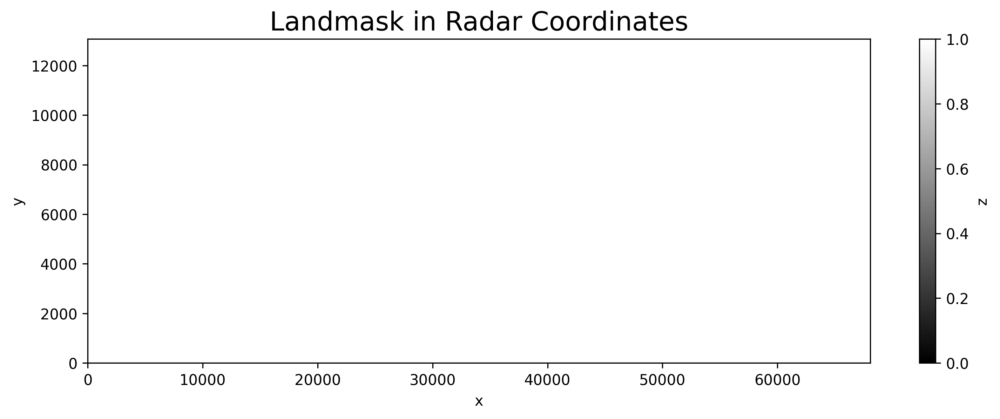

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
landmask_ra.plot.imshow(vmin=0, vmax=1, cmap='gray')
# plt.scatter(EPICENTERS_ra[::2], EPICENTERS_ra[1::2], marker='*', s=100, color='red')
plt.title('Landmask in Radar Coordinates', fontsize=18)
plt.show()

### Load Grids With Landmask

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays.  For a single interferogram processing convert the 3D stack to 2D grid using index [0].

In [ ]:
phasefilt = sbas.open_grids(pairs, 'phasefilt', mask=landmask, geocode=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

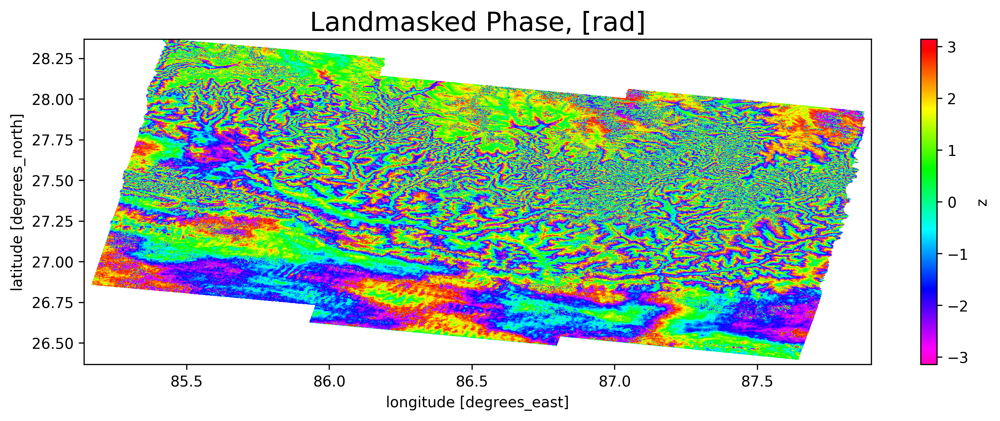

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
phasefilt.plot.imshow(vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Landmasked Phase, [rad]', fontsize=18)
plt.show()

## Unwrapping

Unwrapping process requires a lot of RAM and that's really RAM consuming when a lot of parallel proccesses running togeter. To limit the parallel processing tasks apply argument "n_jobs". The default value n_jobs=-1 means all the processor cores van be used. Also, use interferogram decimation above to produce smaller interferograms. And in addition a custom SNAPHU configuration can reduce RAM usage as explained below.

### Unwrapping Post-Processing

Define post-processing function to exclude low-coherence areas and maybe fill them by nearest neighbour interpolation.

In [ ]:
# define a post-processing function to crop low-coherence areas
#cleaner = lambda corr, unwrap: xr.where(corr>=CORRLIMIT, unwrap, np.nan)

# define a post-processing function to crop and interpolate low-coherence areas
#cleaner = lambda corr, unwrap: sbas.nearest_grid(xr.where(corr>=CORRLIMIT, unwrap, np.nan))

### Generate Custom SNAPHU Config

Default SNAPHU configuration allows to run multiple unwrapping tasks in parallel. At the same time, for a single interferogram processing or large interferograms unwrapping SNAPHU tiling can decrease the both processing time and RAM comsumption. Be careful to prevent unconnected zones on the tiles when a high coherency area is fully arounded by low-coherent buffer on some tiles (redefine tiles or increase tiles row and column overlapping parameters ROWOVRLP and COLOVRLP).

In [ ]:
# use NPROC parameter to define number of cores for the processing, by default all the cores used
# small tiles unwrapping is faster but some details can be missed
# see below the unwrapping time for 2 scenes:
# NTILEROW=4,  NTILECOL=2 - 3h
# NTILEROW=8,  NTILECOL=4 - 1h
# NTILEROW=16, NTILECOL=8 - 0.5h
conf = sbas.snaphu_config(defomax=None,
                          NTILEROW=4,
                          NTILECOL=2,
                          ROWOVRLP=200, COLOVRLP=200)

In [ ]:
# check the generated SNAPHU config and tune the SNAPHU parameters above if needed.
print ('SNAPHU custom config generated:')
print (conf)

SNAPHU custom config generated:

        # basic config
        INFILEFORMAT   FLOAT_DATA
        OUTFILEFORMAT  FLOAT_DATA
        AMPFILEFORMAT  FLOAT_DATA
        CORRFILEFORMAT FLOAT_DATA
        ALTITUDE       693000.0
        EARTHRADIUS    6378000.0
        NEARRANGE      831000
        DR             18.4
        DA             28.2
        RANGERES       28
        AZRES          44
        LAMBDA         0.0554658
        NLOOKSRANGE    1
        NLOOKSAZ       1
        TILEDIR        raw_121/S1_20220318_ALL_F123_snaphu_tiledir
        NPROC          2
        # custom config
        NTILEROW 4
        NTILECOL 2
        ROWOVRLP 200
        COLOVRLP 200



### Interferogram Unwrapping

SNAPHU unwrapper allows to split large scene to tiles for parallel processing and accurately enough merge the tiles to a single image. That's especially helpful to unwrap a single interferogram using all the processor cores and save RAM consumption drastically.

In [ ]:
# debug output enabled to report possible processing issues
#sbas.unwrap_parallel(pairs, n_jobs=1, threshold=CORRLIMIT, func=cleaner, conf=conf, debug=True)

In [ ]:
# "FileNotFoundError" SNAPHU error means the processing is not completed normally for some tiles
# try again with different SNAPHU parameters

# run only one unwrapping task at the time because the custom SNAPHU configuration uses all the cores
sbas.unwrap_parallel(pairs, n_jobs=1, mask=landmask_ra, conf=conf)

Unwrapping:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:distributed.utils_perf:full garbage collection released 132.34 MiB from 42397 reference cycles (threshold: 9.54 MiB)


### Load Grid

The grids can be cropped automatically to drop empty areas around valid area. Use `open_grids(..., crop_valid=True)` to enable the auto cropping feature. Argument geocode=True means on-the-fly geocoding from radar to geographic coordinates (all the grids saved on disk in radar coordinates plus geocoding matrices are generated for the fast geocoding). For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
unwrap = sbas.open_grids(pairs, 'unwrap', geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

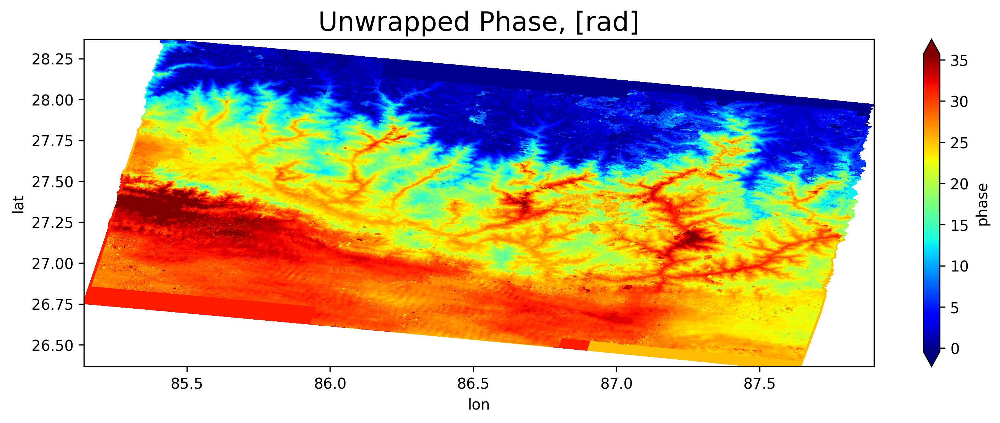

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(unwrap, [0.01, 0.99])
unwrap.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Unwrapped Phase, [rad]', fontsize=18)
plt.show()

## Detrend

In [ ]:
sbas.detrend_parallel(pairs)

Detrending and Saving:   0%|          | 0/1 [00:00<?, ?it/s]

## Load Grid

In [ ]:
unwraps_detrend = sbas.open_grids(pairs, 'detrend', geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

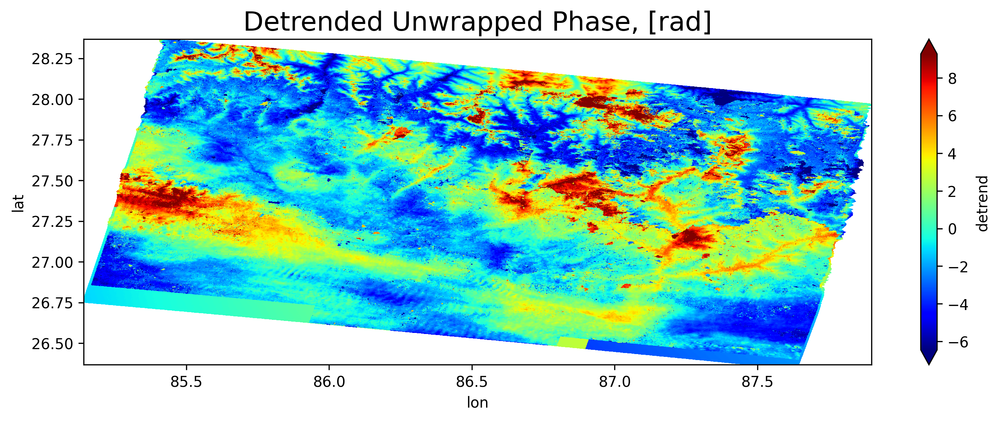

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(unwraps_detrend, [0.01, 0.99])
unwraps_detrend.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Detrended Unwrapped Phase, [rad]', fontsize=18)
plt.show()

## LOS Displacement

### Load and Calculate Grid

The grids can be post-processed using user-defined function "func". SBAS function `los_displacement_mm()` converts unwrapped phase values to LOS displacement in millimeters. For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
los_disp_mm = sbas.open_grids(pairs, 'unwrap', func=sbas.los_displacement_mm, geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
los_disp_detrend_mm = sbas.open_grids(pairs, 'detrend', func=sbas.los_displacement_mm, geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

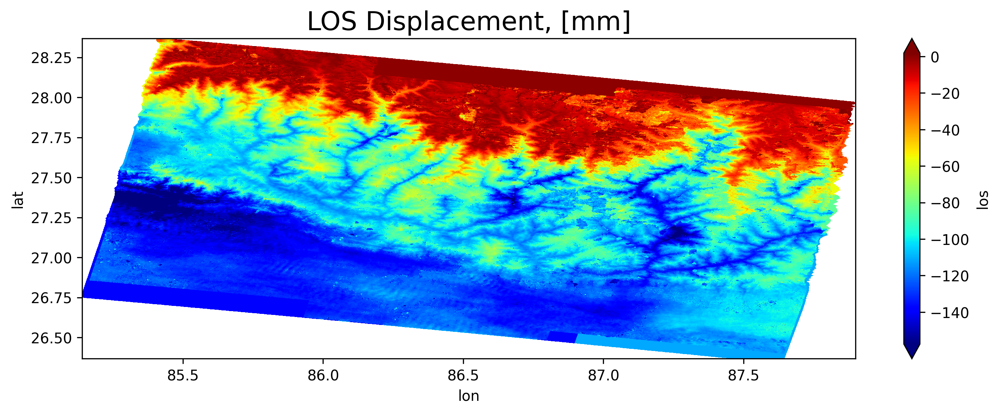

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(los_disp_mm, [0.01, 0.99])
los_disp_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('LOS Displacement, [mm]', fontsize=18)
plt.show()

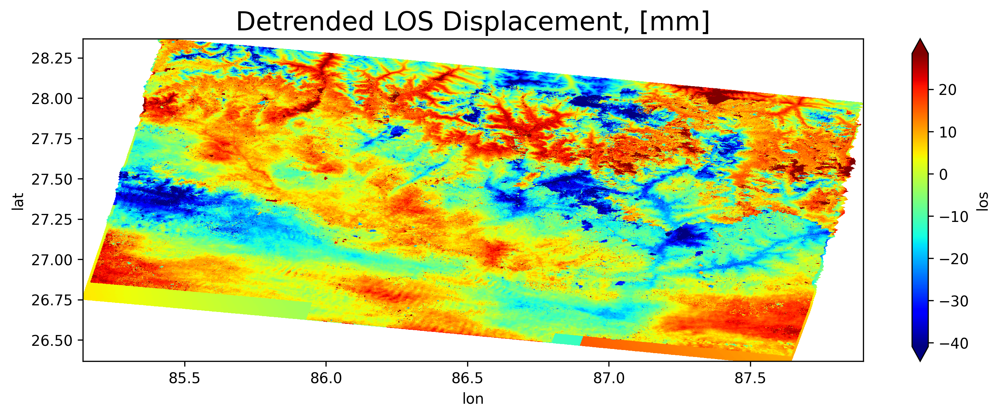

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(los_disp_detrend_mm, [0.01, 0.99])
los_disp_detrend_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Detrended LOS Displacement, [mm]', fontsize=18)
plt.show()

## Vertical and East-West Displacements Projections

LOS displacement projections as vertical and east-west displacements can be calculated using incidence angle defined on the grid.

In [ ]:
sbas.sat_look_parallel()

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
incidence_angle = sbas.incidence_angle()

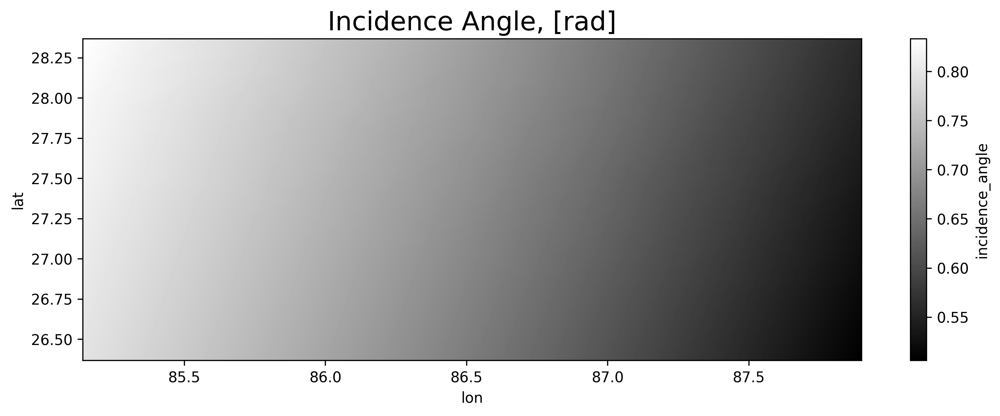

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
incidence_angle.plot.imshow(cmap='gray')
plt.title('Incidence Angle, [rad]', fontsize=18)
plt.show()

### Load and Calculate Grid

The grids can be post-processed using user-defined function "func". SBAS functions `vertical_displacement_mm()` and `eastwest_displacement_mm()` convert unwrapped phase values to vertical and East-West displacements in millimeters. For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
vert_disp_mm = sbas.open_grids(pairs, 'unwrap', func=sbas.vertical_displacement_mm, geocode=True, crop_valid=True)[0]
east_disp_mm = sbas.open_grids(pairs, 'unwrap', func=sbas.eastwest_displacement_mm, geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:distributed.utils_perf:full garbage collection released 83.33 MiB from 19198 reference cycles (threshold: 9.54 MiB)


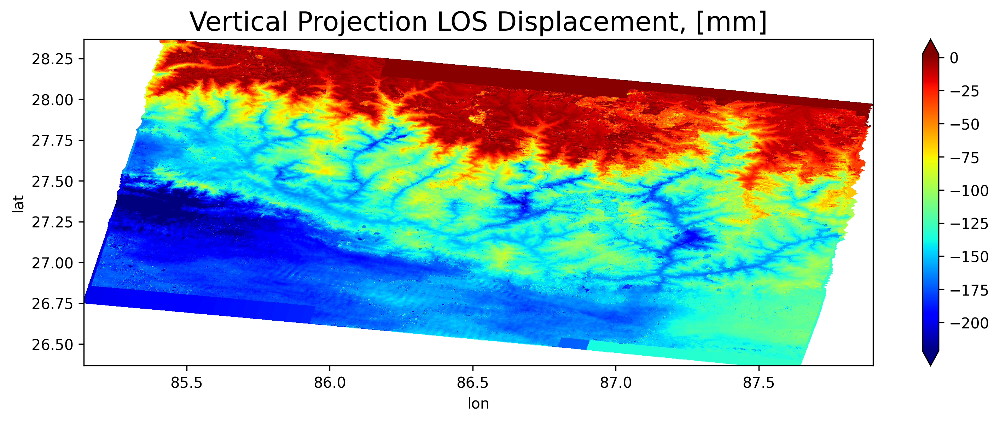

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(vert_disp_mm, [0.01, 0.99])
vert_disp_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('Vertical Projection LOS Displacement, [mm]', fontsize=18)
plt.show()

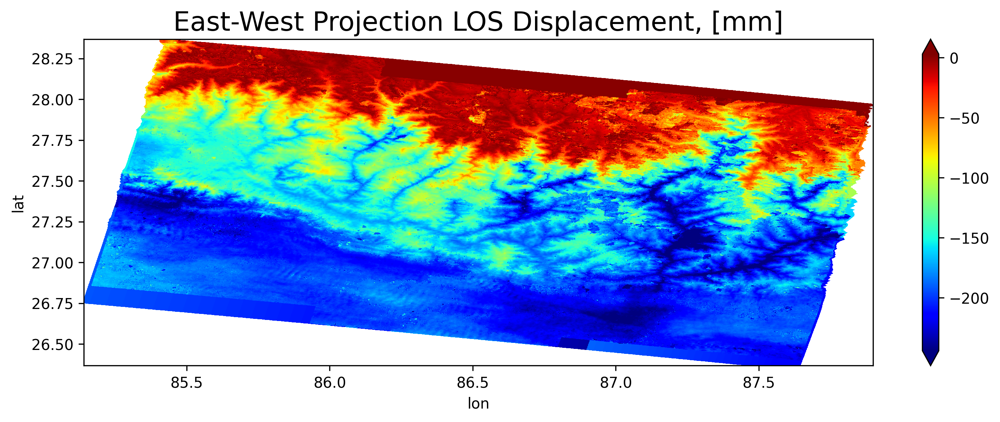

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(east_disp_mm, [0.01, 0.99])
east_disp_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
# plt.scatter(EPICENTERS[::2], EPICENTERS[1::2], marker='*', s=100, color='red')
plt.title('East-West Projection LOS Displacement, [mm]', fontsize=18)
plt.show()

## Save Geographic Coordinates NetCDF Grids

In [ ]:
filename = f'{WORKDIR}.corr.nc'
# drop the existing file first
!rm -fr {filename}
# apply landmask before and geocode later
landmask_ra = sbas.get_landmask(inverse_geocode=True)
corr = sbas.open_grids(pairs, 'corr', mask=landmask_ra, geocode=True, crop_valid=True)[0]
delayed = corr.to_netcdf(filename, engine=sbas.engine, compute=False)
tqdm_dask(dask.persist(delayed), desc='Saving NetCDF')

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Saving NetCDF:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
filename = f'{WORKDIR}.phasefilt.nc'
# drop the existing file first
!rm -fr {filename}
# apply landmask before and geocode later
landmask_ra = sbas.get_landmask(inverse_geocode=True)
phasefilt = sbas.open_grids(pairs, 'phasefilt', mask=landmask_ra, geocode=True, crop_valid=True)[0]
delayed = phasefilt.to_netcdf(filename, engine=sbas.engine, compute=False)
tqdm_dask(dask.persist(delayed), desc='Saving NetCDF')

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Saving NetCDF:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
filename = f'{WORKDIR}.los_disp_detrend_mm.nc'
# drop the existing file first
!rm -fr {filename}
# landmask already applied to unwrapped phase
los_disp_detrend_mm = sbas.open_grids(pairs, 'detrend', func=sbas.los_displacement_mm, geocode=True, crop_valid=True)[0]
delayed = los_disp_detrend_mm.to_netcdf(filename, engine=sbas.engine, compute=False)
tqdm_dask(dask.persist(delayed), desc='Saving NetCDF')

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Saving NetCDF:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

## Download Geographic Coordinates NetCDF Grids from Google Colab

In [2]:
if 'google.colab' in sys.modules:
    from google.colab import files
    files.download(f'{WORKDIR}.phasefilt.nc')
    files.download(f'{WORKDIR}.corr.nc')
    files.download(f'{WORKDIR}.los_disp_detrend_mm.nc')

NameError: ignored